In [4]:
# CORN IMAGE CLASSSIFICATION
import os
import time
import shutil
import pathlib
import itertools
from PIL import Image

import cv2
import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('darkgrid')
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras import regularizers



from sklearn.metrics import classification_report, confusion_matrix

import warnings
warnings.filterwarnings("ignore")

print ('modules loaded')

modules loaded


In [5]:
import matplotlib.pyplot as plt
import random

import torch
from torch.utils.data import DataLoader
from torchvision import transforms, datasets
from torch import nn
from torch.optim import Adam
from torchvision import models


In [6]:
data_path = "dataset" 

# Initialize empty lists to store image file paths and their corresponding labels
images = []
labels = []

# Loop through each subfolder in the main dataset folder
for subfolder in os.listdir(data_path):
    
    # Define the full path to the current subfolder
    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue
  
    # Loop through each image file in the current subfolder
    for image_filename in os.listdir(subfolder_path):
        
        # Get the full path to the image file
        image_path = os.path.join(subfolder_path, image_filename)
        
        # Append the image path to the images list
        images.append(image_path)
    
        # Append the subfolder name (class label) to the labels list
        labels.append(subfolder)
 
data = pd.DataFrame({'image': images, 'label': labels})

In [7]:
data.head()


,image,label
0,dataset/Healthy/Corn_Health (684).jpg,Healthy
1,dataset/Healthy/Corn_Health (5).jpg,Healthy
2,dataset/Healthy/Corn_Health (391).jpg,Healthy
3,dataset/Healthy/Corn_Health (811).jpg,Healthy
4,dataset/Healthy/Corn_Health (112).jpg,Healthy


In [8]:
data.shape


(4188, 2)

In [9]:
# Display the count of images in each class
class_counts = data['label'].value_counts()
print(class_counts)


label
Common_Rust       1306
Healthy           1162
Blight            1146
Gray_Leaf_Spot     574
Name: count, dtype: int64


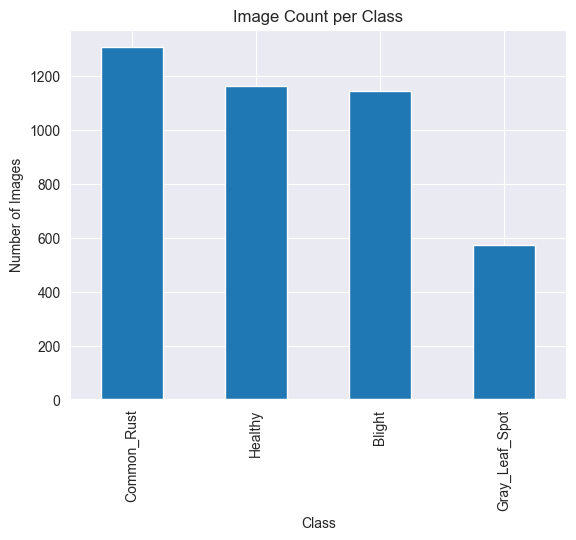

In [10]:
# Visualize the count of images in each class
class_counts.plot(kind='bar')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Image Count per Class')
plt.show()

In [11]:

# Splitting the Data Into Train, Validation and Test Sets¶

# Because the data is not seperated, it should be splitted into Train, Validation and Test sets. 
# To do that, I used splitfolders library and splitted the data into Train, Validation and Test sets 
# by 70%, 20% and 10% respectively.


In [9]:
import splitfolders

In [10]:
splitfolders.ratio("dataset",
            output="splitted_data",
            seed=42,
            ratio=(.7, .2, .1),
            group_prefix=None,
            move=False)

Copying files: 4188 files [00:01, 2538.16 files/s]


In [11]:
# Resizing and Normalizing methods are applied to all of the datasets but data augmentation 
# techniques are only applied to Train set in order to richen the data so that the model possibly 
# will yield more accurate results.

In [12]:
#----------------------
train_transform = transforms.Compose([
    transforms.Resize(size=(256, 256)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.GaussianBlur(kernel_size=(3, 7), sigma=(0.1, 2)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize(size=(256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize(size=(256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
])

# -------- Transformation for the Whole Dataset for Visualization Purposes --------
data_transform = transforms.Compose([
    transforms.Resize(size=(256, 256)),
    transforms.ToTensor(),
])



In [13]:
train = datasets.ImageFolder(root="splitted_data/train",
                              transform=train_transform)

val = datasets.ImageFolder(root="splitted_data/val",
                              transform=val_transform)

test = datasets.ImageFolder(root="splitted_data/test",
                              transform=test_transform)

# -------- Getting the Whole Dataset for Visualization Purposes --------
data = datasets.ImageFolder(root="dataset",
                              transform=data_transform)

In [14]:
print("Dataset Labels:\n", train.class_to_idx, "\n")

for name, dataset in zip(["TRAIN", "VALIDATION", "TEST"], [train, val, test]):
    images_per_class = pd.Series(dataset.targets).value_counts()
    print(f"Images per Class in {name}:")
    print(images_per_class, "\n")

Dataset Labels:
 {'Blight': 0, 'Common_Rust': 1, 'Gray_Leaf_Spot': 2, 'Healthy': 3} 

Images per Class in TRAIN:
1    914
3    813
0    802
2    401
Name: count, dtype: int64 

Images per Class in VALIDATION:
1    261
3    232
0    229
2    114
Name: count, dtype: int64 

Images per Class in TEST:
1    131
3    117
0    115
2     59
Name: count, dtype: int64 



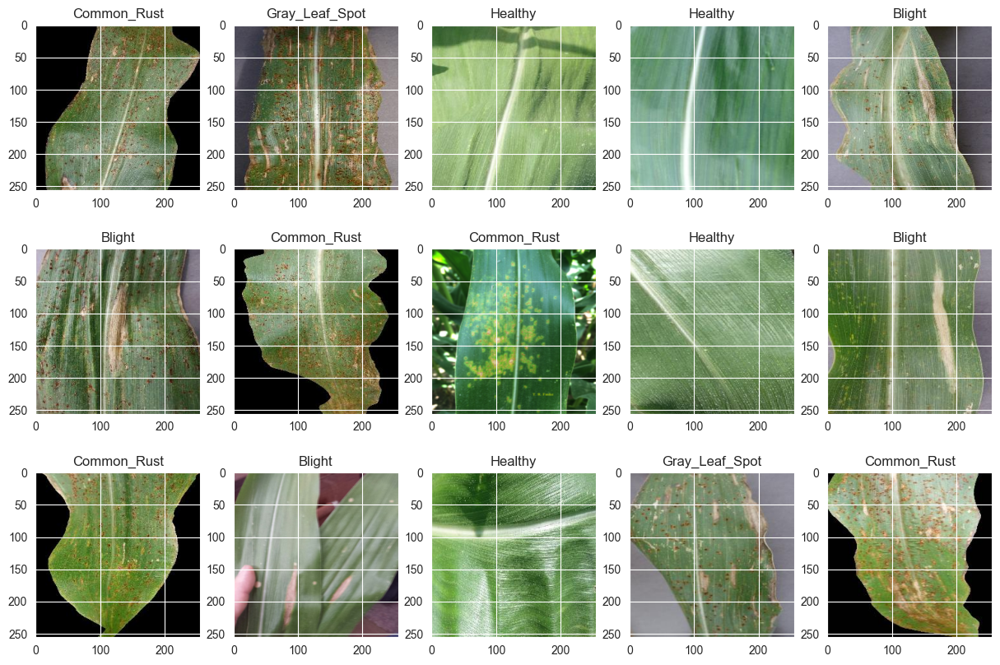

In [15]:


labels_for_viz = {v: k for k, v in data.class_to_idx.items()}

fig, ax = plt.subplots(3, 5, figsize=(15, 10))
ax = ax.flatten()
for i in range(15):
    sample = random.randint(0, len(data))
    ax[i].imshow(data[sample][0].permute(1, 2, 0))
    ax[i].title.set_text(labels_for_viz[data[sample][1]])



In [16]:

# Plotting the Augmented Images

# Because data augmentation methods are applied to Train set, it can be seen that images are blurred, horizontally and vertically flipped compared to the unaugmented images.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6407562].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.3585434].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6998693..2.1134453].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.3431373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6998693..1.308

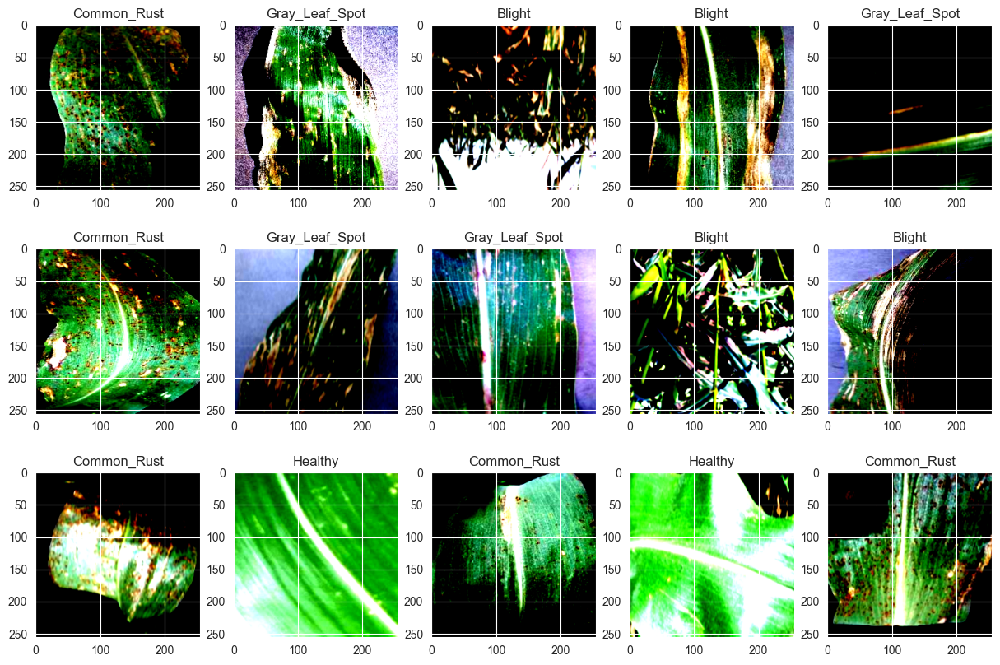

In [17]:
fig, ax = plt.subplots(3, 5, figsize=(15, 10))
ax = ax.flatten()
for i in range(15):
    sample = random.randint(0, len(train))
    ax[i].imshow(train[sample][0].permute(1, 2, 0))
    ax[i].title.set_text(labels_for_viz[train[sample][1]])


In [18]:


# Before passing the data in a neural network, it should be batched and shuffled. 
# Since test will not be used in training process, there is no need to shuffle it.


In [19]:
train_dataloader = DataLoader(dataset=train,
                             batch_size=32,
                             num_workers=2,
                             shuffle=True)

val_dataloader = DataLoader(dataset=val,
                             batch_size=32,
                             num_workers=2,
                             shuffle=True)

test_dataloader = DataLoader(dataset=test,
                             batch_size=32,
                             num_workers=2,
                             shuffle=False)

In [20]:
# When looking at the order of the data in relevant folder, it can be observed that images 
# from class "Blight" comes first, "Common_Rust" second, "Gray_Leaf_Spot" third and "Healthy" last.
# An order as such can be problematic for the model to train unbiasedly. 
# Let's take a batch and look at the labels to make sure that the data is shuffled.

In [21]:
img, label = next(iter(train_dataloader))
print("Batch and Image Shape:", img.shape, "--> [batch_size, color_channels, height, width]")
print("\nLabels:", label)

Batch and Image Shape: torch.Size([32, 3, 256, 256]) --> [batch_size, color_channels, height, width]

Labels: tensor([1, 3, 1, 2, 3, 1, 0, 1, 2, 0, 0, 3, 1, 3, 0, 3, 1, 3, 0, 0, 0, 3, 2, 2,
        0, 0, 1, 3, 3, 2, 1, 1])


In [22]:
model = models.resnet50(pretrained=True)
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, len(train.classes))  # Update for your dataset classes


In [23]:

# 77777777788777777÷-================909====================

In [24]:


# Ignore  the warnings
import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# data visualisation and manipulation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
 
#configure
# sets matplotlib to inline and displays graphs below the corressponding cell.
%matplotlib inline  
style.use('fivethirtyeight')
sns.set(style='whitegrid',color_codes=True)

#model selection
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score,precision_score,recall_score,confusion_matrix,roc_curve,roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder

#preprocess.
# from keras.preprocessing.image import ImageDataGenerator

#dl libraraies
from keras import backend as K
from keras import regularizers
from keras.models import Sequential
from keras.models import Model
from keras.layers import Dense
from keras.optimizers import Adam,SGD,Adagrad,Adadelta,RMSprop
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau
from keras.callbacks import ModelCheckpoint


# specifically for cnn
from keras.layers import Dropout, Flatten,Activation
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from keras.layers import InputLayer
 
import tensorflow as tf
import random as rn

# specifically for manipulating zipped images and getting numpy arrays of pixel values of images.
import cv2                  
import numpy as np  
from tqdm import tqdm
import os                   
from random import shuffle  
from zipfile import ZipFile
from PIL import Image

from keras.applications.resnet50 import ResNet50
import pathlib
import re
import shutil
import random
import skimage as sk
from skimage import io
from skimage.util import img_as_ubyte, img_as_float
from sklearn.metrics import classification_report

from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
import h5py
!pip install mahotas
import mahotas
import pickle
from sklearn import svm
from skimage.transform import resize
from skimage.io import imread
from sklearn import neighbors, datasets
from tensorflow.keras.utils import plot_model



In [25]:
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, BatchNormalization,Dropout,Flatten,Conv2D,MaxPooling2D
# from tensorflow.keras.layers import SeparableConv2D, BatchNormalization, GlobalAveragePooling2D
# import zipfile
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from sklearn.preprocessing import LabelEncoder
# from collections import Counter
# import matplotlib.image as mpimg
# from tensorflow.keras.optimizers import RMSprop, Adam
# from imblearn.over_sampling import SMOTE
# from keras.models import Model
# from keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.applications.vgg16 import VGG16


In [26]:
# !pip install git+https://github.com/qubvel/classification_models.git

In [27]:
import os
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import transforms, datasets, models
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

# Constants
IMAGE_SIZE = 224
BATCH_SIZE = 32
NUM_CLASSES = 4
EPOCHS = 10
LEARNING_RATE = 0.001

# Data Augmentation and Normalization
train_transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# Loading Dataset
data_dir = "splitted_data/"
train_dataset = datasets.ImageFolder(os.path.join(data_dir, "train"), transform=train_transform)
val_dataset = datasets.ImageFolder(os.path.join(data_dir, "val"), transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4)

# Model Definition
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
model = models.resnet50(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, NUM_CLASSES)  # Modify output layer
model = model.to(device)

# Loss and Optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

# Training Loop
def train_model(model, train_loader, val_loader, criterion, optimizer, epochs):
    
    for epoch in range(epochs):
        # Training
        model.train()
        train_loss = 0
        correct = 0
        total = 0
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

        train_acc = 100. * correct / total

        # Validation
        model.eval()
        val_loss = 0
        correct = 0
        total = 0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)

                val_loss += loss.item()
                _, predicted = outputs.max(1)
                total += labels.size(0)
                correct += predicted.eq(labels).sum().item()

        val_acc = 100. * correct / total
        
        val_loss /= len(val_loader)
        
        # Save metrics for this epoch
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        # Print Progress
        print(f"Epoch [{epoch+1}/{epochs}], "
              f"Train Loss: {train_loss/len(train_loader):.4f}, Train Acc: {train_acc:.2f}%, "
              f"Val Loss: {val_loss/len(val_loader):.4f}, Val Acc: {val_acc:.2f}%")

In [38]:
# Train the model
# train_model(model, train_loader, val_loader, criterion, optimizer, EPOCHS)
train_model(model, train_loader, val_loader, criterion, optimizer, EPOCHS)

Epoch [1/10], Train Loss: 0.4897, Train Acc: 81.43%, Val Loss: 0.0193, Val Acc: 83.01%
Epoch [2/10], Train Loss: 0.3138, Train Acc: 87.61%, Val Loss: 0.0101, Val Acc: 89.00%
Epoch [3/10], Train Loss: 0.2664, Train Acc: 89.28%, Val Loss: 0.0100, Val Acc: 87.44%
Epoch [4/10], Train Loss: 0.2323, Train Acc: 90.61%, Val Loss: 0.0075, Val Acc: 90.91%
Epoch [5/10], Train Loss: 0.2139, Train Acc: 92.05%, Val Loss: 0.0069, Val Acc: 92.34%
Epoch [6/10], Train Loss: 0.2081, Train Acc: 91.50%, Val Loss: 0.0079, Val Acc: 90.55%
Epoch [7/10], Train Loss: 0.1924, Train Acc: 92.73%, Val Loss: 0.0082, Val Acc: 90.79%
Epoch [8/10], Train Loss: 0.1811, Train Acc: 93.07%, Val Loss: 0.0060, Val Acc: 93.78%
Epoch [9/10], Train Loss: 0.1863, Train Acc: 92.25%, Val Loss: 0.0104, Val Acc: 90.91%
Epoch [10/10], Train Loss: 0.2072, Train Acc: 91.95%, Val Loss: 0.0078, Val Acc: 91.63%


In [39]:

# Save the model
torch.save(model.state_dict(), "resnet50_corn_disease_PRECOPY.pth")

In [40]:
from torch.utils.data import DataLoader

# Assuming test_dataset and test_transform are defined
test_dataset = datasets.ImageFolder(os.path.join(data_dir, "test"), transform=val_transform)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4)

def evaluate_model(model, test_loader, criterion):
    model.eval()  # Set the model to evaluation mode
    test_loss = 0
    correct = 0
    total = 0
    
    with torch.no_grad():  # Disable gradient computation
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
    
    test_acc = 100. * correct / total
    test_loss /= len(test_loader)
    
    return test_loss, test_acc

# Evaluate the model
test_loss, test_acc = evaluate_model(model, test_loader, criterion)
print(f'\nTest Accuracy: {test_acc:.2f}%  Test Loss: {test_loss:.4f}')



Test Accuracy: 91.47%  Test Loss: 0.2046


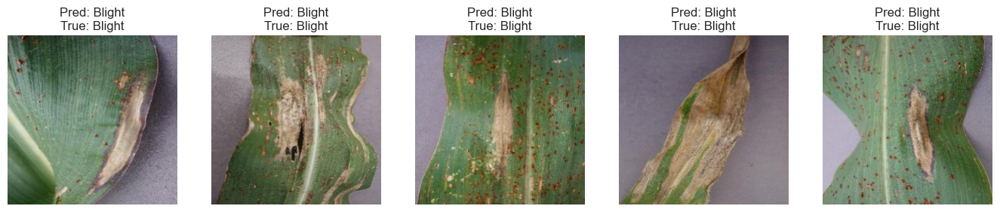

In [41]:

import matplotlib.pyplot as plt

def visualize_predictions(model, test_loader):
    model.eval()
    images, labels = next(iter(test_loader))
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    _, preds = outputs.max(1)
    
    fig, axes = plt.subplots(1, 5, figsize=(15, 5))
    for i in range(5):
        ax = axes[i]
        img = images[i].cpu().permute(1, 2, 0).numpy()
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  # Unnormalize
        img = np.clip(img, 0, 1)
        ax.imshow(img)
        ax.set_title(f'Pred: {test_dataset.classes[preds[i]]}\nTrue: {test_dataset.classes[labels[i]]}')
        ax.axis('off')
    plt.show()

# Call the function to visualize
visualize_predictions(model, test_loader)



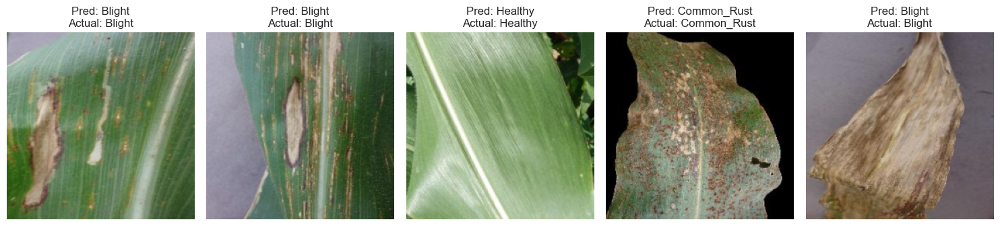

In [42]:
import matplotlib.pyplot as plt
import random

def visualize_random_predictions(model, test_loader, num_images=5):
    """
    Visualize random predictions for a given number of images from the test dataset.
    
    Args:
        model: Trained model for predictions.
        test_loader: DataLoader for the test dataset.
        num_images: Number of random images to display.
    """
    model.eval()
    
    # Get a random batch of images and labels
    all_images, all_labels = [], []
    for images, labels in test_loader:
        all_images.append(images)
        all_labels.append(labels)
    
    # Combine all batches into one dataset
    all_images = torch.cat(all_images, dim=0)
    all_labels = torch.cat(all_labels, dim=0)

    # Select random indices for visualization
    random_indices = random.sample(range(len(all_images)), num_images)
    images = all_images[random_indices]
    labels = all_labels[random_indices]

    # Move images and labels to the device
    images, labels = images.to(device), labels.to(device)
    
    # Get model predictions
    outputs = model(images)
    _, preds = outputs.max(1)
    
    # Visualize the selected images
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
    for i in range(num_images):
        ax = axes[i]
        img = images[i].cpu().permute(1, 2, 0).numpy()
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  # Unnormalize
        img = np.clip(img, 0, 1)
        ax.imshow(img)
        ax.set_title(f'Pred: {test_dataset.classes[preds[i]]}\nActual: {test_dataset.classes[labels[i]]}')
        ax.axis('off')
    plt.tight_layout()
    plt.show()

# Call the function
visualize_random_predictions(model, test_loader, num_images=5)


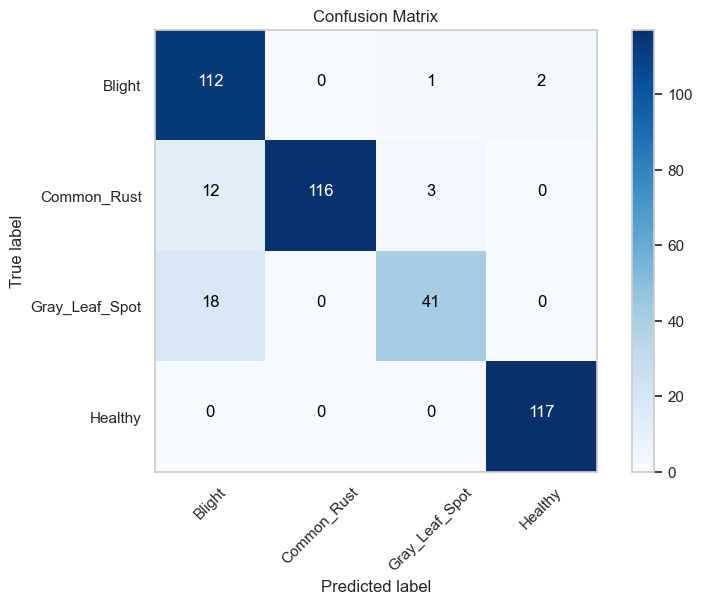

In [43]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate predictions for the test set
def get_predictions_and_labels(model, test_loader):
    model.eval()
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    return np.array(all_preds), np.array(all_labels)

# Get predictions and labels
predicted_labels, true_labels = get_predictions_and_labels(model, test_loader)

# Compute confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Plot confusion matrix
def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.grid(False)
    plt.show()
    
# Call the plotting function
class_names = test_dataset.classes
plot_confusion_matrix(cm, classes=class_names)


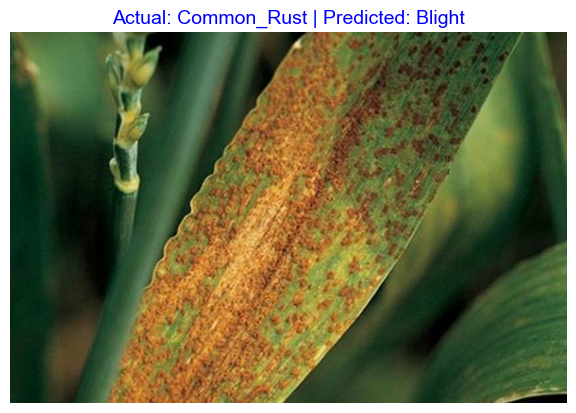

In [44]:
# Path to the image
img_path = 'dataset/Common_Rust/Corn_Common_Rust (2).jpg'  # Update the path to your image

# Load and preprocess the image
def preprocess_image(img_path):
    image_transforms = transforms.Compose([
        transforms.Resize((224, 224)),  # Resize to match ResNet input size
        transforms.ToTensor(),  # Convert image to tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize as done during training
                             std=[0.229, 0.224, 0.225])
    ])
    img = Image.open(img_path).convert("RGB")  # Ensure the image is in RGB format
    return image_transforms(img).unsqueeze(0)  # Add batch dimension

# Extract the actual class from the folder name in the image path
actual_class = os.path.basename(os.path.dirname(img_path))

# Preprocess the image
img_tensor = preprocess_image(img_path).to(device)

# Make predictions with the ResNet model
model.eval()  # Set the model to evaluation mode
with torch.no_grad():
    outputs = model(img_tensor)
    predicted_class_idx = torch.argmax(outputs, dim=1).item()  # Get the predicted class index

# Map the prediction back to the class label
class_labels = test_dataset.classes
predicted_label = class_labels[predicted_class_idx]

# Display the image with predicted and actual class labels
plt.imshow(Image.open(img_path))  # Display the original image (not resized)
plt.title(f"Actual: {actual_class} | Predicted: {predicted_label}", color='blue', fontsize=14)
plt.axis('off')  # Hide axes for a cleaner look
plt.show()


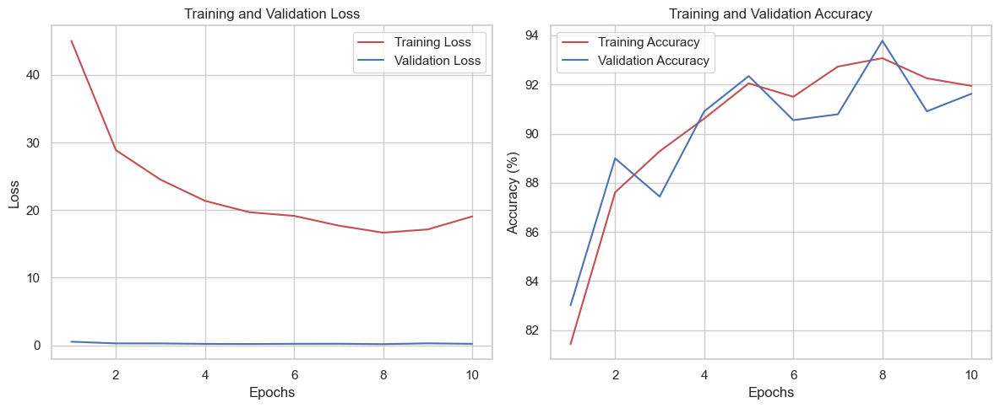

In [45]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    epochs = range(1, len(history['train_loss']) + 1)
    
    # Plot Training and Validation Loss
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history['train_loss'], 'r-', label='Training Loss')
    plt.plot(epochs, history['val_loss'], 'b-', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    
    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history['train_acc'], 'r-', label='Training Accuracy')
    plt.plot(epochs, history['val_acc'], 'b-', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

# Call the function to plot the learning curves
plot_learning_curves(history)


# Hyper parameter tuning

In [28]:
# Required imports
import torch
import torch.nn as nn
from torchvision import models


# Reload the model
NUM_CLASSES = 4  
model = models.resnet50(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, NUM_CLASSES)  # Match the number of classes
model.load_state_dict(torch.load("saved_models/resnet50_corn_disease_PRECOPY.pth"))
model = model.to(device)

In [30]:
learning_rates = [0.0001, 0.0005, 0.001, 0.005]


In [31]:
optimizer = torch.optim.SGD(model.parameters(), lr=LEARNING_RATE, momentum=0.9)


In [32]:
batch_sizes = [16, 32, 64]


In [33]:
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)


In [ ]:
best_val_acc = 0
best_params = {}

for lr in [0.0001, 0.001, 0.01]:
    for batch_size in [16, 32]:
        # Update DataLoader
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
        
        # Update Optimizer
        optimizer = torch.optim.Adam(model.parameters(), lr=lr)
        
        # Train Model
        train_model(model, train_loader, val_loader, criterion, optimizer, EPOCHS)
        
        # Check Validation Accuracy
        val_acc = history['val_acc'][-1]  # Get last validation accuracy
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_params = {'learning_rate': lr, 'batch_size': batch_size}
            torch.save(model.state_dict(), "best_tuned_model.pth")

print("Best Parameters:", best_params)
print("Best Validation Accuracy:", best_val_acc)


# Grad CAM ++ IMPLEMENTATION for above RESNET50 MODEL

In [47]:

def tensor_to_image(tensor):
    """
    Converts a PyTorch tensor into a NumPy array suitable for visualization.
    Args:
        tensor (torch.Tensor): A tensor of shape (C, H, W) with values normalized (mean/std).
    Returns:
        np.ndarray: A NumPy array of shape (H, W, C) in the range [0, 1].
    """
    tensor = tensor.cpu().clone().detach()  # Ensure the tensor is on the CPU
    tensor = tensor.numpy().transpose(1, 2, 0)  # Convert to (H, W, C)
    # Un-normalize using ImageNet mean and std
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    tensor = std * tensor + mean  # Reverse normalization
    tensor = np.clip(tensor, 0, 1)  # Clip values to [0, 1] range
    return tensor

In [48]:

def plot_value_array(logit, label, class_names):
    """
    Plots a bar chart of predicted probabilities and highlights the true class.
    
    Args:
        logit (torch.Tensor): The model's output logits for a single image.
        label (torch.Tensor): The true label for the image.
        class_names (list): A list of class names.
    """
    # Convert logits to probabilities
    probabilities = torch.softmax(logit.squeeze(), dim=0).cpu().numpy()
    label = label.item()

    # Plot the probabilities
    plt.bar(range(len(class_names)), probabilities, color="gray")
    plt.xticks(range(len(class_names)), class_names, rotation=45, ha="right")
    plt.ylabel("Probability")
    plt.xlabel("Class")
    plt.ylim(0, 1)

    # Highlight the true class in green
    plt.bar(label, probabilities[label], color="green")
    # Highlight the predicted class in red (if different from true class)
    predicted_class = np.argmax(probabilities)
    if predicted_class != label:
        plt.bar(predicted_class, probabilities[predicted_class], color="red")


Generating Grad-CAM++ visualizations...


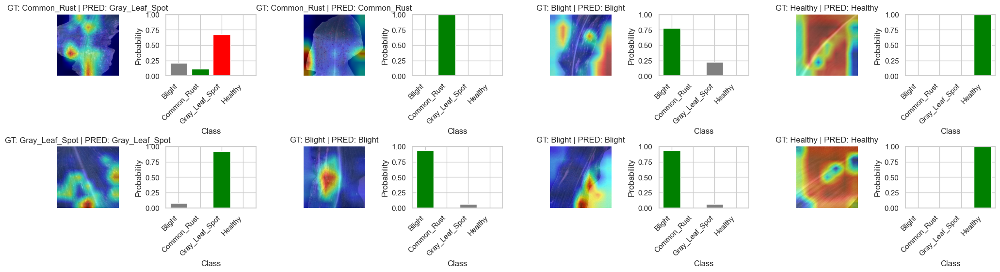

In [51]:
# Grad-CAM++ inference and visualization
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam.utils.image import show_cam_on_image
def gradcam_inference(model, test_loader, class_names, num_images=8, rows=2):
    """
    Performs Grad-CAM++ visualization on a set of random test images.
    """
    model.eval()
    images, labels, logits = [], [], []
    with torch.no_grad():
        for image_batch, label_batch in test_loader:
            image_batch, label_batch = image_batch.to(device), label_batch.to(device)
            output = model(image_batch)
            images.extend(image_batch)  # Collect all images
            logits.extend(output)      # Collect logits
            labels.extend(label_batch) # Collect labels
    
    print("Generating Grad-CAM++ visualizations...")
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]], use_cuda=torch.cuda.is_available())
    sampled_indices = random.sample(range(len(images)), num_images)  # Sample random indices
    
    # Fix the number of subplots to accommodate both Grad-CAM++ visualizations and bar charts
    cols = num_images  # Number of columns in the plot grid
    total_plots = num_images * 2  # Each image has 2 plots (Grad-CAM++ and bar chart)
    plt.figure(figsize=(20, 10))
    count = 1
    for idx in sampled_indices:
        img_tensor = images[idx].unsqueeze(0)  # Add batch dimension for Grad-CAM++
        logit = logits[idx].unsqueeze(0)       # Add batch dimension for logits
        lbl = labels[idx]                      # Scalar label

        # Convert tensor to image
        img = tensor_to_image(img_tensor[0])
        grayscale_cam = cam(input_tensor=img_tensor)
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)
        
        # Display the image with Grad-CAM++
        plt.subplot(rows, cols, count)
        plt.imshow(visualization)
        plt.axis('off')
        plt.title(f"GT: {class_names[lbl.item()]} | PRED: {class_names[logit.argmax(1).item()]}")
        count += 1

        # Display the prediction probabilities
        plt.subplot(rows, cols, count)
        plot_value_array(logit, lbl, class_names)
        count += 1
    plt.tight_layout()
    plt.show()

# Example usage
class_names = test_dataset.classes
gradcam_inference(model, test_loader, class_names, num_images=8, rows=4)


Generating Grad-CAM++ visualizations...


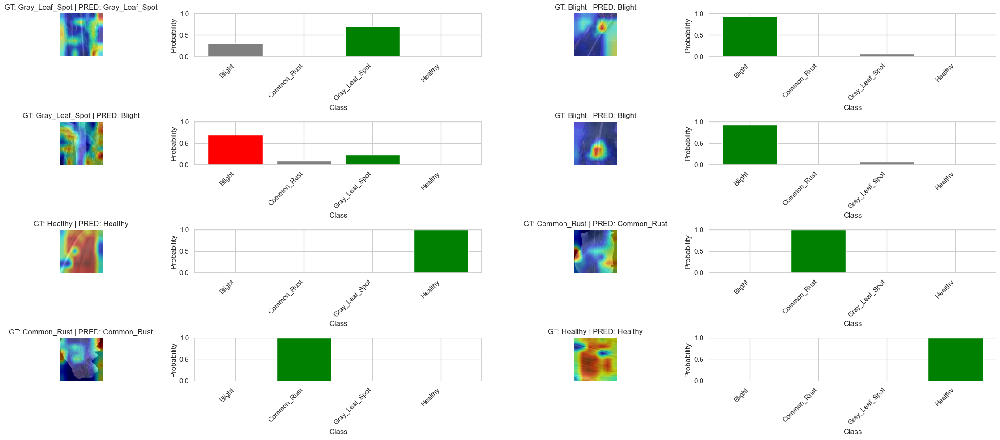

In [52]:
# Grad-CAM++ inference and visualization with better layout
def gradcam_inference(model, test_loader, class_names, num_images=8, cols=2):
    """
    Performs Grad-CAM++ visualization on a set of random test images.
    Args:
        model: Trained model.
        test_loader: DataLoader for the test set.
        class_names: List of class names.
        num_images: Number of random images to visualize.
        cols: Number of columns for the grid layout.
    """
    model.eval()
    images, labels, logits = [], [], []
    with torch.no_grad():
        for image_batch, label_batch in test_loader:
            image_batch, label_batch = image_batch.to(device), label_batch.to(device)
            output = model(image_batch)
            images.extend(image_batch)  # Collect all images
            logits.extend(output)      # Collect logits
            labels.extend(label_batch) # Collect labels
    
    print("Generating Grad-CAM++ visualizations...")
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]], use_cuda=torch.cuda.is_available())
    sampled_indices = random.sample(range(len(images)), num_images)  # Sample random indices
    
    # Adjust the figure size and rows dynamically
    rows = num_images // cols
    plt.figure(figsize=(cols * 6, rows * 5))  # Make each image larger by increasing figure size
    count = 1
    for idx in sampled_indices:
        img_tensor = images[idx].unsqueeze(0)  # Add batch dimension for Grad-CAM++
        logit = logits[idx].unsqueeze(0)       # Add batch dimension for logits
        lbl = labels[idx]                      # Scalar label

        # Convert tensor to image
        img = tensor_to_image(img_tensor[0])
        grayscale_cam = cam(input_tensor=img_tensor)
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)
        
        # Display the image with Grad-CAM++
        plt.subplot(rows * 2, cols, count)
        plt.imshow(visualization)
        plt.axis('off')
        plt.title(f"GT: {class_names[lbl.item()]} | PRED: {class_names[logit.argmax(1).item()]}", fontsize=12)
        count += 1

        # Display the prediction probabilities
        plt.subplot(rows * 2, cols, count)
        plot_value_array(logit, lbl, class_names)
        count += 1
    plt.tight_layout()
    plt.show()

# Example usage
class_names = test_dataset.classes
gradcam_inference(model, test_loader, class_names, num_images=8, cols=4)


Generating Grad-CAM++ visualizations...


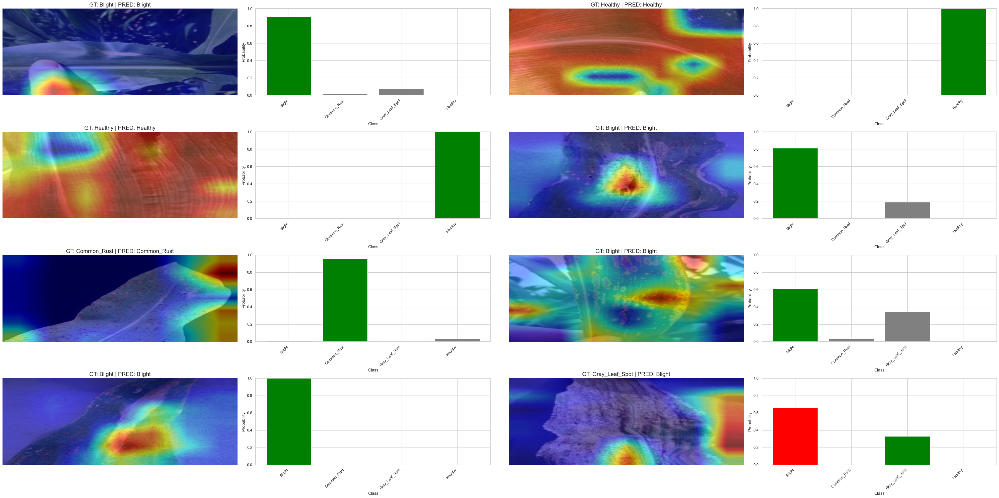

In [53]:
# Grad-CAM++ inference and visualization with larger images
def gradcam_inference(model, test_loader, class_names, num_images=8, cols=2):
    """
    Performs Grad-CAM++ visualization on a set of random test images with increased image size.
    Args:
        model: Trained model.
        test_loader: DataLoader for the test set.
        class_names: List of class names.
        num_images: Number of random images to visualize.
        cols: Number of columns for the grid layout.
    """
    model.eval()
    images, labels, logits = [], [], []
    with torch.no_grad():
        for image_batch, label_batch in test_loader:
            image_batch, label_batch = image_batch.to(device), label_batch.to(device)
            output = model(image_batch)
            images.extend(image_batch)  # Collect all images
            logits.extend(output)      # Collect logits
            labels.extend(label_batch) # Collect labels
    
    print("Generating Grad-CAM++ visualizations...")
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]], use_cuda=torch.cuda.is_available())
    sampled_indices = random.sample(range(len(images)), num_images)  # Sample random indices
    
    # Adjust the figure size dynamically based on the number of columns and rows
    rows = num_images // cols
    plt.figure(figsize=(cols * 10, rows * 10))  # Larger figure size for bigger images
    count = 1
    for idx in sampled_indices:
        img_tensor = images[idx].unsqueeze(0)  # Add batch dimension for Grad-CAM++
        logit = logits[idx].unsqueeze(0)       # Add batch dimension for logits
        lbl = labels[idx]                      # Scalar label

        # Convert tensor to image
        img = tensor_to_image(img_tensor[0])
        grayscale_cam = cam(input_tensor=img_tensor)
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)
        
        # Display the image with Grad-CAM++
        plt.subplot(rows * 2, cols, count)
        plt.imshow(visualization, aspect='auto')
        plt.axis('off')
        plt.title(f"GT: {class_names[lbl.item()]} | PRED: {class_names[logit.argmax(1).item()]}", fontsize=16)
        count += 1

        # Display the prediction probabilities
        plt.subplot(rows * 2, cols, count)
        plot_value_array(logit, lbl, class_names)
        count += 1
    plt.tight_layout()
    plt.show()

# Example usage
class_names = test_dataset.classes
gradcam_inference(model, test_loader, class_names, num_images=8, cols=4)


Generating Grad-CAM++ visualizations...


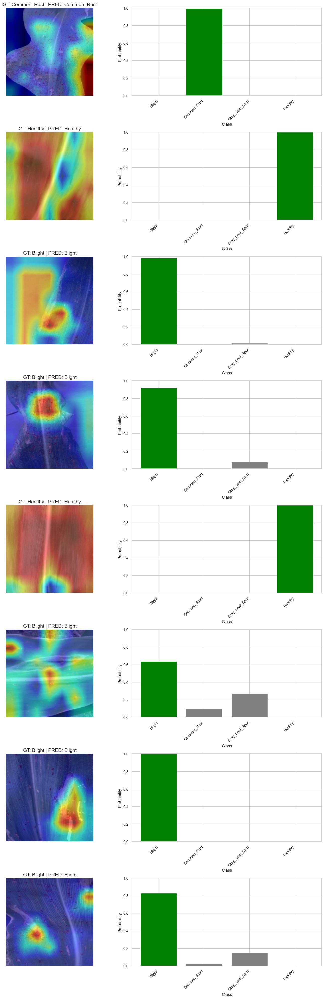

In [54]:
# Grad-CAM++ inference and visualization with one image and its graph in a single row
def gradcam_inference_single_row(model, test_loader, class_names, num_images=8):
    """
    Performs Grad-CAM++ visualization on a set of random test images with one image and its graph per row.
    """
    model.eval()
    images, labels, logits = [], [], []
    with torch.no_grad():
        for image_batch, label_batch in test_loader:
            image_batch, label_batch = image_batch.to(device), label_batch.to(device)
            output = model(image_batch)
            images.extend(image_batch)  # Collect all images
            logits.extend(output)      # Collect logits
            labels.extend(label_batch) # Collect labels
    
    print("Generating Grad-CAM++ visualizations...")
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]], use_cuda=torch.cuda.is_available())
    sampled_indices = random.sample(range(len(images)), num_images)  # Sample random indices
    
    # Adjust figure size and layout
    plt.figure(figsize=(15, num_images * 5))  # Dynamic height based on the number of images
    count = 1
    for idx in sampled_indices:
        img_tensor = images[idx].unsqueeze(0)  # Add batch dimension for Grad-CAM++
        logit = logits[idx].unsqueeze(0)       # Add batch dimension for logits
        lbl = labels[idx]                      # Scalar label

        # Convert tensor to image
        img = tensor_to_image(img_tensor[0])
        grayscale_cam = cam(input_tensor=img_tensor)
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)
        
        # Grad-CAM++ visualization
        plt.subplot(num_images, 2, count)
        plt.imshow(visualization)
        plt.axis('off')
        plt.title(f"GT: {class_names[lbl.item()]} | PRED: {class_names[logit.argmax(1).item()]}", fontsize=14)
        count += 1

        # Prediction probabilities
        plt.subplot(num_images, 2, count)
        plot_value_array(logit, lbl, class_names)
        count += 1
    plt.tight_layout()
    plt.show()

# Example usage
class_names = test_dataset.classes
gradcam_inference_single_row(model, test_loader, class_names, num_images=8)


Generating Grad-CAM++ visualizations...


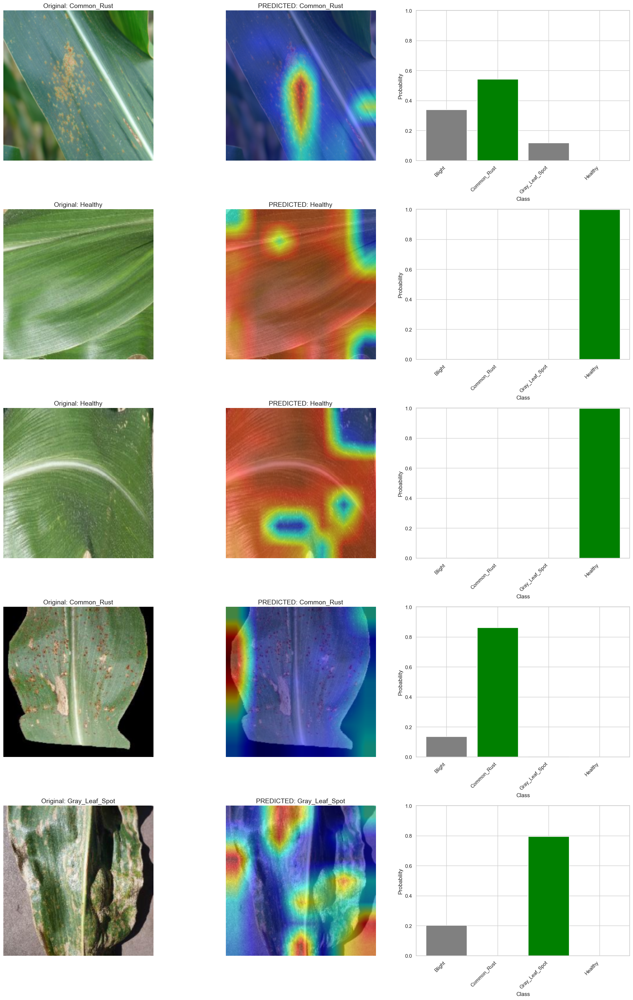

In [55]:
# Grad-CAM++ inference and visualization with original image, Grad-CAM++ explanation, and graph
def gradcam_inference_with_original(model, test_loader, class_names, num_images=8):
    """
    Performs Grad-CAM++ visualization on a set of random test images with original image, Grad-CAM++ visualization,
    and its graph in a single row.
    """
    model.eval()
    images, labels, logits = [], [], []
    with torch.no_grad():
        for image_batch, label_batch in test_loader:
            image_batch, label_batch = image_batch.to(device), label_batch.to(device)
            output = model(image_batch)
            images.extend(image_batch)  # Collect all images
            logits.extend(output)      # Collect logits
            labels.extend(label_batch) # Collect labels
    
    print("Generating Grad-CAM++ visualizations...")
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]], use_cuda=torch.cuda.is_available())
    sampled_indices = random.sample(range(len(images)), num_images)  # Sample random indices
    
    # Adjust figure size and layout
    plt.figure(figsize=(20, num_images * 6))  # Dynamic height for better spacing
    count = 1
    for idx in sampled_indices:
        img_tensor = images[idx].unsqueeze(0)  # Add batch dimension for Grad-CAM++
        logit = logits[idx].unsqueeze(0)       # Add batch dimension for logits
        lbl = labels[idx]                      # Scalar label

        # Convert tensor to image
        img = tensor_to_image(img_tensor[0])
        grayscale_cam = cam(input_tensor=img_tensor)
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)

        # Display the original image
        plt.subplot(num_images, 3, count)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Original: {class_names[lbl.item()]}", fontsize=14)
        count += 1

        # Display the Grad-CAM++ visualization
        plt.subplot(num_images, 3, count)
        plt.imshow(visualization)
        plt.axis('off')
        plt.title(f"PREDICTED: {class_names[logit.argmax(1).item()]}", fontsize=14)
        count += 1

        # Display the prediction probabilities
        plt.subplot(num_images, 3, count)
        plot_value_array(logit, lbl, class_names)
        count += 1

    plt.tight_layout()
    plt.show()

# Example usage
class_names = test_dataset.classes
gradcam_inference_with_original(model, test_loader, class_names, num_images=5)


# LIME ++ IMPLEMENTATION for above RESNET50 MODEL

In [56]:
# LIME EXPLNATIONS

In [57]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from lime import lime_image
from skimage.segmentation import mark_boundaries
from torchvision import transforms
import torch


In [58]:

# Define your preprocessing transform for LIME
def get_preprocess_transform():
    """
    Prepares a preprocessing transform compatible with ResNet50 in PyTorch.
    """
    return transforms.Compose([
        transforms.Resize((224, 224)),  # Resize to 224x224
        transforms.ToTensor(),         # Convert to tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet stats
                             std=[0.229, 0.224, 0.225]),
    ])

preprocess_transform = get_preprocess_transform()


In [59]:

# Define batch prediction function
def batch_predict(images):
    """
    Predict function for LIME that takes a batch of images and returns predictions.
    Args:
        images: List of images in NumPy format.
    Returns:
        Prediction probabilities for each image.
    """
    model.eval()
    images = np.array(images) / 255.0  # Normalize pixel values to [0, 1]
    transformed_images = torch.stack([preprocess_transform(Image.fromarray((img * 255).astype('uint8'))) for img in images])
    transformed_images = transformed_images.to(device)
    
    with torch.no_grad():
        outputs = model(transformed_images)
        probabilities = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    return probabilities


In [76]:
# Load and preprocess the image

# image_path = 'dataset/Common_Rust/Blight (3).jpg'  
image_path = 'splitted_data/test/Common_Rust/Corn_Common_Rust (31).jpg'
# image_path = 'dataset/Blight/Corn_Blight (100).jpg'
img = Image.open(image_path)

# Convert to RGB if necessary
if img.mode != 'RGB':
    img = img.convert('RGB')

# Resize the image to model input size
img = img.resize((224, 224))

# Convert to array
input_img = np.array(img)


In [77]:

# Initialize LIME image explainer
explainer = lime_image.LimeImageExplainer(random_state=42)

# Get the explanation for the top classes
explanation = explainer.explain_instance(
    input_img,         # Input image in array format
    batch_predict,     # Prediction function
    top_labels=5,      # Number of top classes to explain
    hide_color=0,      # Background color for hidden regions (0 is black)
    num_samples=1000   # Number of perturbed samples for explanation
)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:31<00:00, 31.78it/s]


In [78]:

# Print the top 5 predictions with their probabilities
class_names = list(test_dataset.classes)  # Class names from your test dataset
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]
top5_idx = probs.argsort()[-5:][::-1]

print("Top 5 predictions:")
for idx in top5_idx:
    print(f"Class {class_names[idx]}: {probs[idx]:.4f}")


Top 5 predictions:
Class Common_Rust: 0.9912
Class Blight: 0.0075
Class Gray_Leaf_Spot: 0.0013
Class Healthy: 0.0001


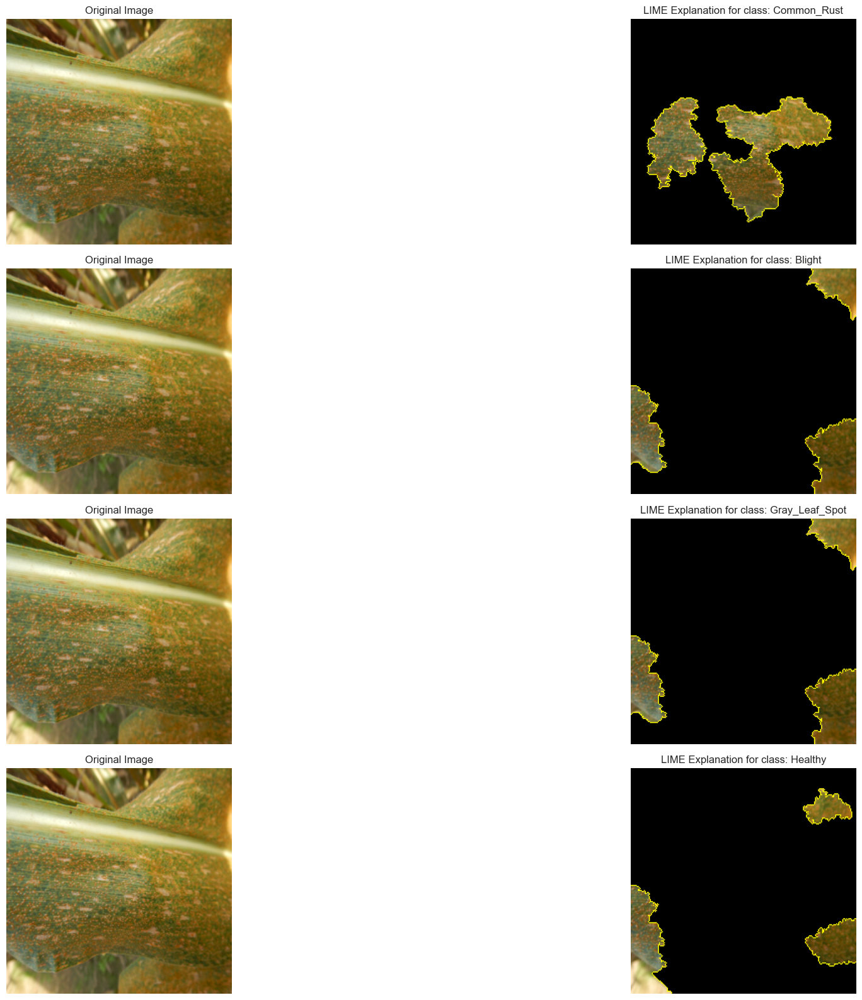

In [79]:

# Visualize explanations for the top 5 predicted classes
plt.figure(figsize=(20, 4 * 5))
for idx, label in enumerate(explanation.top_labels):
    temp, mask = explanation.get_image_and_mask(
        label, positive_only=True, num_features=5, hide_rest=True
    )
    
    img_boundary = mark_boundaries(temp / 255.0, mask)

    # Original image
    plt.subplot(5, 2, 2 * idx + 1)
    plt.imshow(img)
    plt.title('Original Image')
    plt.axis('off')

    # LIME explanation
    plt.subplot(5, 2, 2 * idx + 2)
    plt.imshow(img_boundary)
    class_name = class_names[label]  # Map label index to class name
    plt.title(f"LIME Explanation for class: {class_name}")
    plt.axis('off')

plt.tight_layout()
plt.show()


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:32<00:00, 31.17it/s]


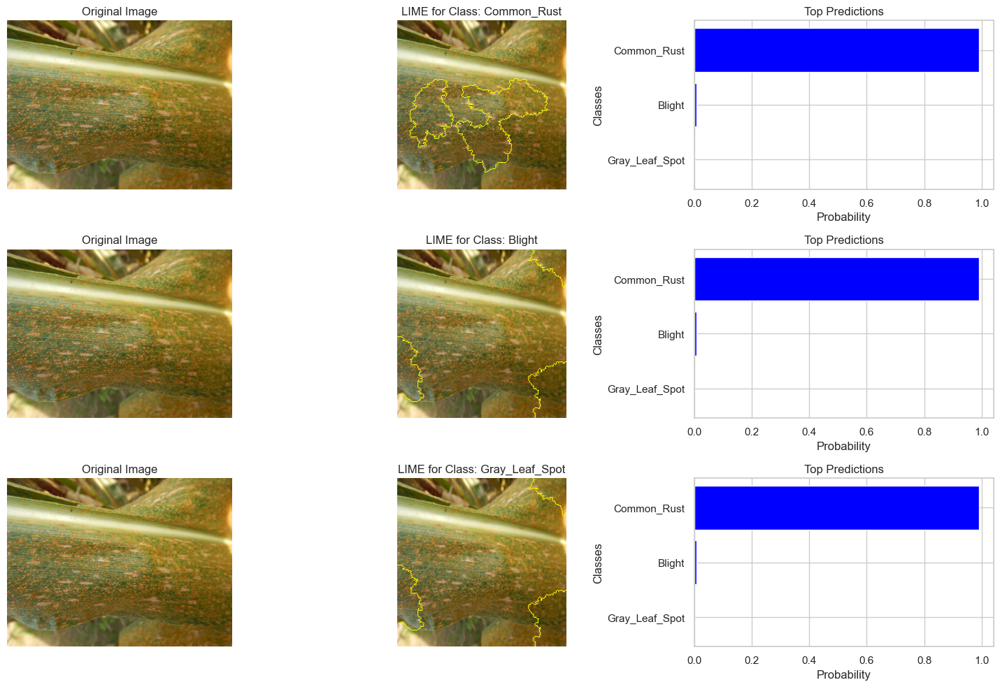

In [80]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from lime import lime_image
from skimage.segmentation import mark_boundaries
from torchvision import transforms
import torch

# Define your preprocessing transform for LIME
def get_preprocess_transform():
    """
    Prepares a preprocessing transform compatible with ResNet50 in PyTorch.
    """
    return transforms.Compose([
        transforms.Resize((224, 224)),  # Resize to 224x224
        transforms.ToTensor(),         # Convert to tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet stats
                             std=[0.229, 0.224, 0.225]),
    ])

preprocess_transform = get_preprocess_transform()

# Define batch prediction function
def batch_predict(images):
    """
    Predict function for LIME that takes a batch of images and returns predictions.
    Args:
        images: List of images in NumPy format.
    Returns:
        Prediction probabilities for each image.
    """
    model.eval()
    images = np.array(images) / 255.0  # Normalize pixel values to [0, 1]
    transformed_images = torch.stack([preprocess_transform(Image.fromarray((img * 255).astype('uint8'))) for img in images])
    transformed_images = transformed_images.to(device)
    
    with torch.no_grad():
        outputs = model(transformed_images)
        probabilities = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    return probabilities

# Plot Prediction Graph
def plot_prediction_graph(probs, class_names, top_labels):
    """
    Plot the prediction probabilities as a bar chart.
    Args:
        probs: Probabilities for all classes.
        class_names: List of class names.
        top_labels: List of top predicted class indices.
    """
    top_probs = probs[top_labels]
    top_class_names = [class_names[idx] for idx in top_labels]
    
    plt.barh(top_class_names, top_probs, color='blue')
    plt.xlabel("Probability")
    plt.ylabel("Classes")
    plt.title("Top Predictions")
    plt.gca().invert_yaxis()  # Invert to have the highest prediction on top

# Main function for LIME Explanation with visualization
def lime_explanation_with_visualization(img_path, model, class_names):
    """
    Generate LIME explanations for an image and display:
    - Original Image
    - LIME Explanation
    - Prediction Graph
    """
    # Load and preprocess the image
    img = Image.open(img_path)
    if img.mode != 'RGB':
        img = img.convert('RGB')
    input_img = np.array(img.resize((224, 224)))
    
    # Initialize LIME explainer
    explainer = lime_image.LimeImageExplainer(random_state=42)
    explanation = explainer.explain_instance(
        input_img,
        batch_predict,
        top_labels=5,
        hide_color=0,
        num_samples=1000
    )
    
    # Get the top predictions
    probs = batch_predict(np.expand_dims(input_img, axis=0))[0]
    top_labels = explanation.top_labels[:3]  # Focus on the top 3 labels for simplicity
    
    # Visualization
    plt.figure(figsize=(15, 10))
    for i, label in enumerate(top_labels):
        temp, mask = explanation.get_image_and_mask(
            label, positive_only=True, num_features=5, hide_rest=False
        )
        img_boundary = mark_boundaries(temp / 255.0, mask)
        
        # Plot Original Image
        plt.subplot(len(top_labels), 3, i * 3 + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title("Original Image")
        
        # Plot LIME Explanation
        plt.subplot(len(top_labels), 3, i * 3 + 2)
        plt.imshow(img_boundary)
        plt.axis('off')
        plt.title(f"LIME for Class: {class_names[label]}")
        
        # Plot Prediction Graph
        plt.subplot(len(top_labels), 3, i * 3 + 3)
        plot_prediction_graph(probs, class_names, top_labels)
    
    plt.tight_layout()
    plt.show()

# Example usage
# img_path = "dataset/Common_Rust/Corn_Common_Rust (2).jpg"  # Replace with your image path
img_path = 'splitted_data/test/Common_Rust/Corn_Common_Rust (31).jpg'
class_names = test_dataset.classes  # List of class names
lime_explanation_with_visualization(img_path, model, class_names)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:33<00:00, 30.09it/s]


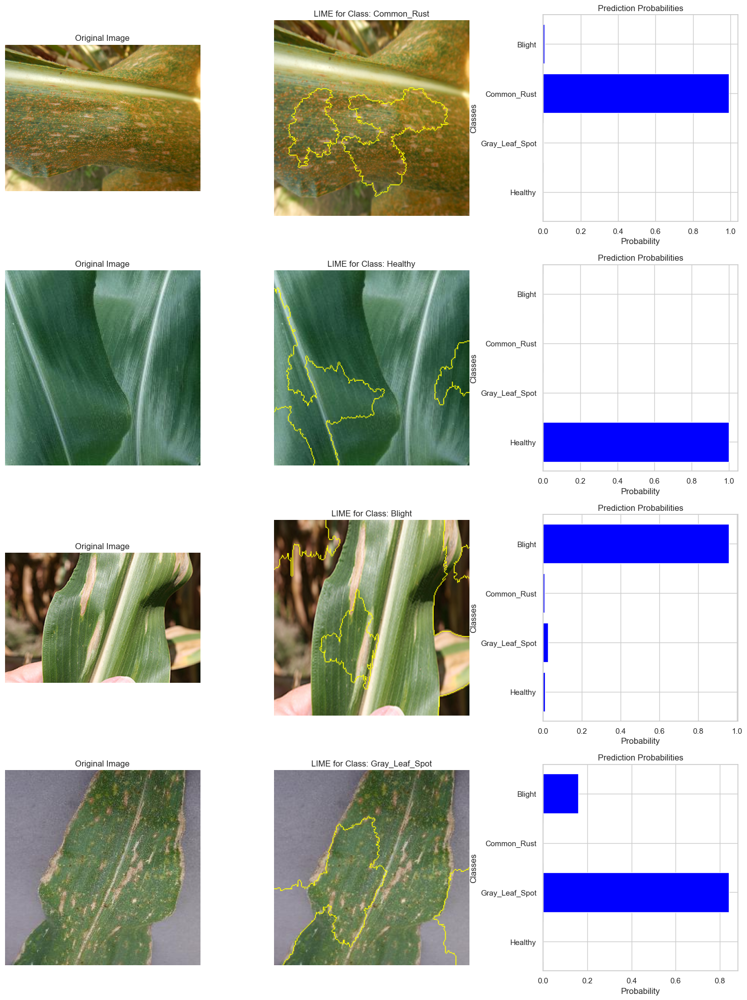

In [81]:
# Plot Prediction Graph for All Classes
def plot_prediction_graph_all_classes(probs, class_names):
    """
    Plot the prediction probabilities for all classes as a bar chart.
    Args:
        probs: Probabilities for all classes.
        class_names: List of all class names.
    """
    plt.barh(class_names, probs, color='blue')
    plt.xlabel("Probability")
    plt.ylabel("Classes")
    plt.title("Prediction Probabilities")
    plt.gca().invert_yaxis()  # Invert to have the highest class on top

# LIME Explanation for Multiple Images
def lime_explanations_for_multiple_images(image_paths, model, class_names):
    """
    Generate LIME explanations for multiple images and display:
    - Original Image
    - LIME Highlighted Image
    - Prediction Graph for All Classes
    """
    # Initialize LIME explainer
    explainer = lime_image.LimeImageExplainer(random_state=42)
    
    plt.figure(figsize=(15, len(image_paths) * 5))
    
    for i, img_path in enumerate(image_paths):
        # Load and preprocess the image
        img = Image.open(img_path)
        if img.mode != 'RGB':
            img = img.convert('RGB')
        input_img = np.array(img.resize((224, 224)))
        
        # Get LIME explanation
        explanation = explainer.explain_instance(
            input_img,
            batch_predict,
            top_labels=5,
            hide_color=0,
            num_samples=1000
        )
        
        # Get prediction probabilities
        probs = batch_predict(np.expand_dims(input_img, axis=0))[0]
        top_label = explanation.top_labels[0]  # Focus on the top predicted label
        
        # Get LIME visualization
        temp, mask = explanation.get_image_and_mask(
            top_label,
            positive_only=True,
            num_features=5,
            hide_rest=False
        )
        img_boundary = mark_boundaries(temp / 255.0, mask)
        
        # Display Original Image
        plt.subplot(len(image_paths), 3, i * 3 + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title("Original Image")
        
        # Display LIME Highlighted Image
        plt.subplot(len(image_paths), 3, i * 3 + 2)
        plt.imshow(img_boundary)
        plt.axis('off')
        plt.title(f"LIME for Class: {class_names[top_label]}")
        
        # Display Prediction Graph for All Classes
        plt.subplot(len(image_paths), 3, i * 3 + 3)
        plot_prediction_graph_all_classes(probs, class_names)
    
    plt.tight_layout()
    plt.show()

# Example usage
image_paths = [
    "dataset/Common_Rust/Corn_Common_Rust (31).jpg",  # Replace with your image paths
    "dataset/Healthy/Corn_Health (9).jpg",
    "dataset/Blight/Corn_Blight (100).jpg",
    "dataset/Gray_Leaf_Spot/Corn_Gray_Spot (104).JPG"
]
class_names = test_dataset.classes  # List of class names
lime_explanations_for_multiple_images(image_paths, model, class_names)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:32<00:00, 30.47it/s]


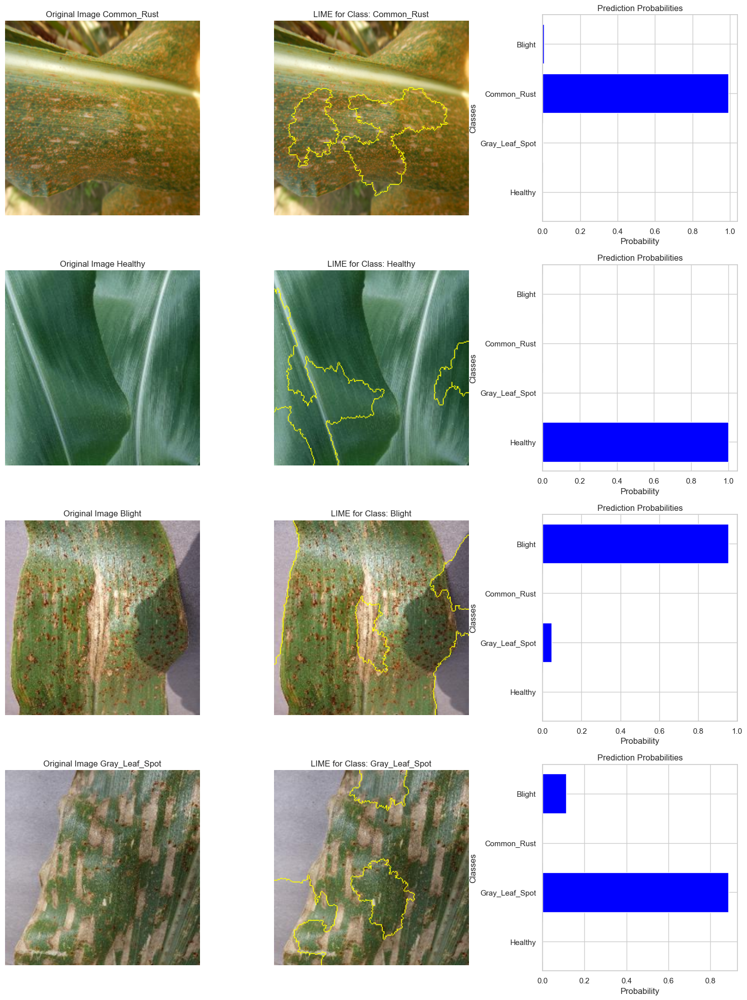

In [82]:

import numpy as np
import matplotlib.pyplot as plt
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image

# Function: Preprocess image for LIME
def preprocess_image(img_path, target_size=(224, 224)):
    """
    Preprocess an image for LIME visualization.
    Args:
        img_path: Path to the image file.
        target_size: Target size for resizing (default: (224, 224)).
    Returns:
        Preprocessed NumPy array of the image.
    """
    img = Image.open(img_path)
    if img.mode != 'RGB':
        img = img.convert('RGB')
    return np.array(img.resize(target_size))

# Function: Plot prediction graph for all classes
def plot_prediction_graph(probs, class_names):
    """
    Plot the prediction probabilities for all classes as a bar chart.
    Args:
        probs: Probabilities for all classes.
        class_names: List of all class names.
    """
    plt.barh(class_names, probs, color='blue')
    plt.xlabel("Probability")
    plt.ylabel("Classes")
    plt.title("Prediction Probabilities")
    plt.gca().invert_yaxis()  # Invert to have the highest class on top

# Function: Visualize LIME explanation
def visualize_lime_explanation(input_img, explanation, top_label, class_name):
    """
    Visualize LIME explanation for an image.
    Args:
        input_img: Original input image as a NumPy array.
        explanation: LIME explanation object.
        top_label: The top predicted label for the image.
        class_name: The class name for the top label.
    """
    temp, mask = explanation.get_image_and_mask(
        top_label,
        positive_only=True,
        num_features=5,
        hide_rest=False
    )
    img_boundary = mark_boundaries(temp / 255.0, mask)
    return img_boundary

# Function: Generate LIME explanations for multiple images
def generate_lime_explanations(image_paths, batch_predict_fn, class_names, model):
    """
    Generate LIME explanations for multiple images and display:
    - Original Image
    - LIME Highlighted Image
    - Prediction Graph for All Classes
    Args:
        image_paths: List of image file paths.
        batch_predict_fn: Batch prediction function for the model.
        class_names: List of all class names.
        model: Trained model.
    """
    explainer = lime_image.LimeImageExplainer(random_state=42)
    plt.figure(figsize=(15, len(image_paths) * 5))
    
    for i, img_path in enumerate(image_paths):
        # Preprocess image
        input_img = preprocess_image(img_path)
        
        # Generate LIME explanation
        explanation = explainer.explain_instance(
            input_img,
            batch_predict_fn,
            top_labels=len(class_names),
            hide_color=0,
            num_samples=1000
        )
        
        # Get prediction probabilities and top label
        probs = batch_predict_fn(np.expand_dims(input_img, axis=0))[0]
        top_label = explanation.top_labels[0]
        
        # Visualize LIME explanation
        img_boundary = visualize_lime_explanation(input_img, explanation, top_label, class_names[top_label])
        
        # Plot Original Image
        plt.subplot(len(image_paths), 3, i * 3 + 1)
        plt.imshow(input_img / 255.0)
        plt.axis('off')
        plt.title(f"Original Image {class_names[top_label]}")
        
        # Plot LIME Highlighted Image
        plt.subplot(len(image_paths), 3, i * 3 + 2)
        plt.imshow(img_boundary)
        plt.axis('off')
        plt.title(f"LIME for Class: {class_names[top_label]}")
        
        # Plot Prediction Graph for All Classes
        plt.subplot(len(image_paths), 3, i * 3 + 3)
        plot_prediction_graph(probs, class_names)
    
    plt.tight_layout()
    plt.show()

# Example usage
image_paths = [
    "splitted_data/test/Common_Rust/Corn_Common_Rust (31).jpg",  # Replace with your image paths
    "dataset/Healthy/Corn_Health (9).jpg",
    "dataset/Blight/Corn_Blight (1000).jpg",
    "dataset/Gray_Leaf_Spot/Corn_Gray_Spot (161).JPG"
]

class_names = test_dataset.classes  # List of class names
generate_lime_explanations(image_paths, batch_predict, class_names, model)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:32<00:00, 31.00it/s]


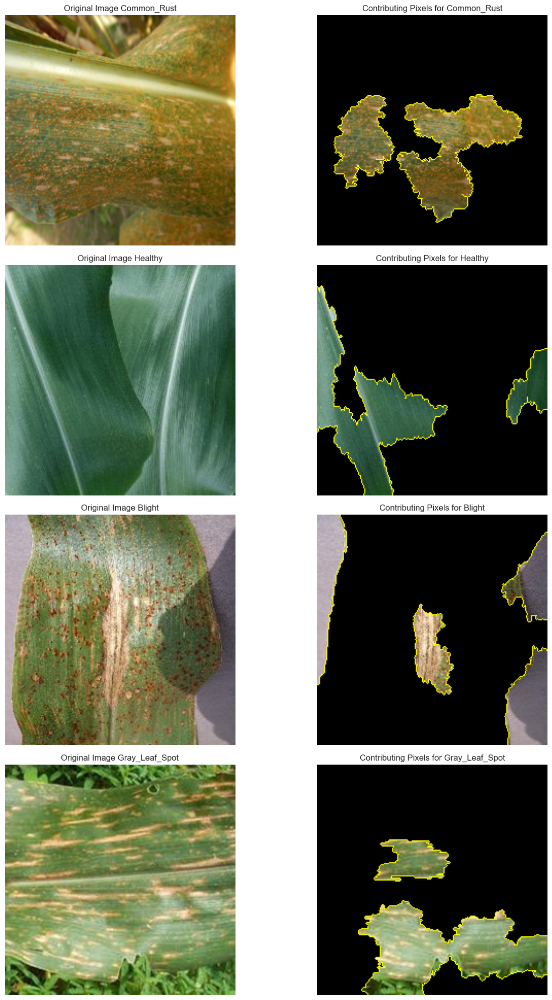

In [83]:
# Visualize Pixels Contributing to the Prediction
def visualize_contributing_pixels(image_paths, batch_predict_fn, class_names):
    """
    Generate and display LIME explanations highlighting pixels contributing to the predictions.
    Args:
        image_paths: List of image file paths.
        batch_predict_fn: Batch prediction function for the model.
        class_names: List of all class names.
    """
    explainer = lime_image.LimeImageExplainer(random_state=42)
    plt.figure(figsize=(15, len(image_paths) * 5))
    
    for i, img_path in enumerate(image_paths):
        # Preprocess image
        input_img = preprocess_image(img_path)
        
        # Generate LIME explanation
        explanation = explainer.explain_instance(
            input_img,
            batch_predict_fn,
            top_labels=len(class_names),
            hide_color=0,
            num_samples=1000
        )
        
        # Get prediction probabilities and top label
        probs = batch_predict_fn(np.expand_dims(input_img, axis=0))[0]
        top_label = explanation.top_labels[0]
        
        # Highlight contributing pixels
        temp, mask = explanation.get_image_and_mask(
            top_label,
            positive_only=True,  # Show only positively contributing regions
            num_features=5,      # Number of important superpixels
            hide_rest=True        # Hide non-contributing regions
        )
        contributing_pixels = mark_boundaries(temp / 255.0, mask)
        
        # Display Original Image
        plt.subplot(len(image_paths), 2, i * 2 + 1)
        plt.imshow(input_img / 255.0)
        plt.axis('off')
#         plt.title("Original Image")
        plt.title(f"Original Image {class_names[top_label]}")
        
        # Display Contributing Pixels
        plt.subplot(len(image_paths), 2, i * 2 + 2)
        plt.imshow(contributing_pixels)
        plt.axis('off')
        plt.title(f"Contributing Pixels for {class_names[top_label]}")
    
    plt.tight_layout()
    plt.show()

# Example usage
image_paths = [
    "dataset/Common_Rust/Corn_Common_Rust (31).jpg",  # Replace with your image paths
    "dataset/Healthy/Corn_Health (9).jpg",
    "dataset/Blight/Corn_Blight (1000).jpg",
    "dataset/Gray_Leaf_Spot/Corn_Gray_Spot (11).jpg"
]
class_names = test_dataset.classes  # List of class names
visualize_contributing_pixels(image_paths, batch_predict, class_names)
